Setup

In [ ]:
!pip install opencv-python==3.4.2.17 opencv-contrib-python==3.4.2.17

Import dependencies

In [1]:
import numpy as np
import cv2
import math
import matplotlib.pyplot as plt
from google.colab.patches import cv2_imshow
import time

Confirm cv2 version for task 2

In [2]:
print(cv2.__version__)

3.4.2


Read img

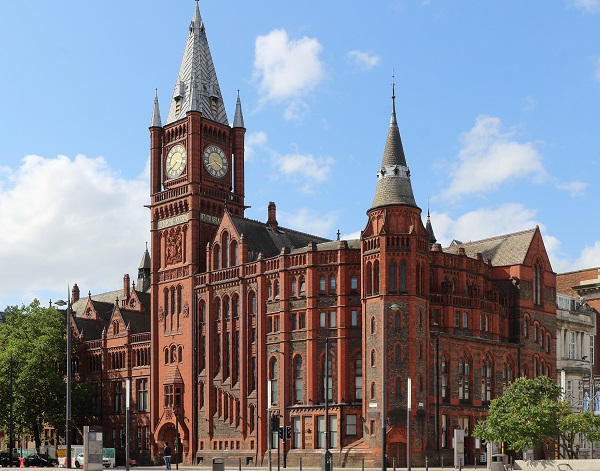

In [ ]:
img = cv2.imread("victoria.jpg")
cv2_imshow(img)

In [ ]:
print(img.shape)

(471, 600, 3)


# Problem 1

In [2]:
img = cv2.imread("victoria.jpg")
img2 = cv2.imread("victoria2.jpg")

Convert to grayscale

(471, 600)


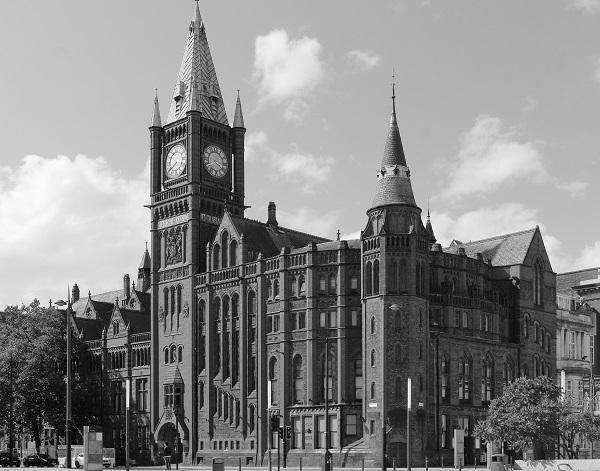

(887, 1024)


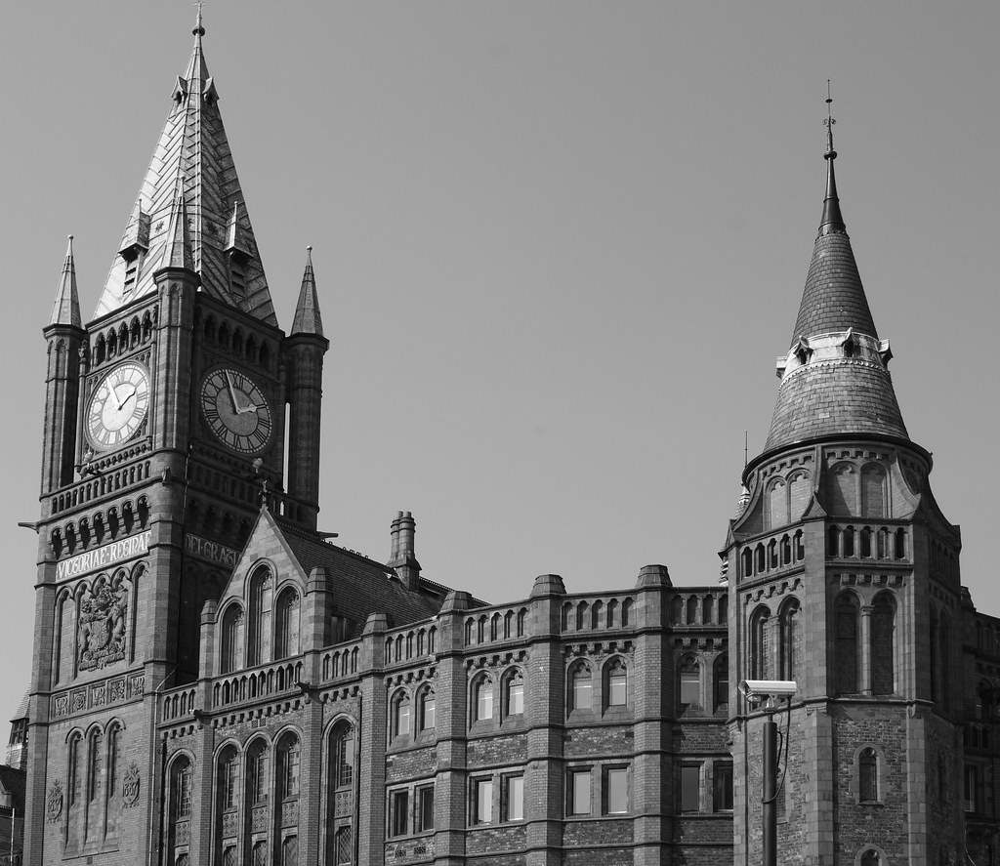

In [3]:
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
print(gray.shape)
cv2_imshow(gray)

gray2 = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)
print(gray2.shape)
cv2_imshow(gray2)

##Own Conv2d implementation with padding and stride

In [4]:
def Padding(img, padding):
    if padding is None:
        return img
    elif padding == "zero":
        return np.pad(img, (1,1), "constant", constant_values=(0,0))

In [5]:
def conv2d(input, kernel, padding=None, stride=1):
    # padding
    input = Padding(input, padding)

    # kernel check
    ker_shape = kernel.shape
    assert ker_shape[0] == ker_shape[1], "Non-square kernel error!"
    assert ker_shape[0] % 2 == ker_shape[1] % 2 == 1, "Even kernel shape error!"
    
    # shape match check
    h, w = input.shape
    img_shape = input.shape
    
    # out shape gen
    output = np.zeros([int((img_shape[0]-ker_shape[0])/stride)+1,int((img_shape[1]-ker_shape[1])/stride)+1])
    #print(output.shape)

    # kernel shape and half size for align and border check
    kh, kw = ker_shape
    pfh, pfw = int(kh/2), int(kw/2)

    x,y = 0,0
    #print(img_shape)

    for i in range(h):
        # input/output row exit

        if h-1-i < pfh: break
        if x == output.shape[0]: break
        for j in range(w):
            if (i < pfh or j < pfw):
                continue 
            if (w-1-j) <= pfw:
                break
                print('b')
            if (h-1-i) <= pfh:
                break
                print('b')
            if j % stride == 0:
                # calculate current window mask border on input image
                il = i-pfh
                ir = i+pfh
                jl = j-pfw
                jr = j+pfw

                # border align
                if ir+1 == h:
                    it = input.shape[0]
                else:
                    it = ir+1
                if jr+1 == w:
                    jt = input.shape[1]
                else:
                    jt = jr+1

                # exception catch diagnostics
                try:
                    output[x,y] = np.sum(np.multiply(kernel, input[il:it, jl:jt]))
                except Exception as ex:
                    template = "An exception of type {0} occurred. Arguments:\n{1!r}"
                    message = template.format(type(ex).__name__, ex.args)
                    print(message)
                    print(il, it, jl, jt)
                    print('x:',x,'y',y)

                y += 1 # col ++
        
        y = 0 # col reset
        x += 1 # row ++

    return output

### 3x3 Edge Kernel Test

(469, 598)


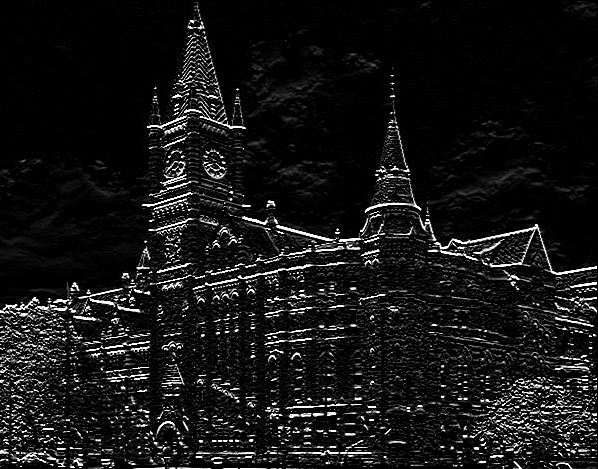

[[ 0.00e+00  0.00e+00  0.00e+00 ...  0.00e+00  0.00e+00  0.00e+00]
 [ 0.00e+00  0.00e+00  0.00e+00 ... -1.10e+01 -6.00e+00  0.00e+00]
 [ 0.00e+00  0.00e+00  0.00e+00 ...  0.00e+00 -1.00e+00  0.00e+00]
 ...
 [ 1.47e+02 -3.13e+02 -3.67e+02 ...  6.00e+00  1.20e+01  0.00e+00]
 [-5.09e+02 -8.91e+02 -1.02e+03 ...  4.70e+01  2.70e+01  0.00e+00]
 [-4.62e+02 -4.28e+02 -3.74e+02 ...  3.60e+01  2.80e+01  0.00e+00]]


In [6]:
kernel = np.array([[1,3,1],[0,0,0],[-1,-3,-1]])
dst = conv2d(gray, kernel)
print(dst.shape)
cv2_imshow(dst)
print(dst)

##3x3 ROI result compare with hand calculation

In [93]:
print(gray[0:3,0:3])

[[197 197 197]
 [197 197 197]
 [197 197 197]]


result pixel value should be 0

In [7]:
print(dst[0,0])

0.0


(885, 1022)


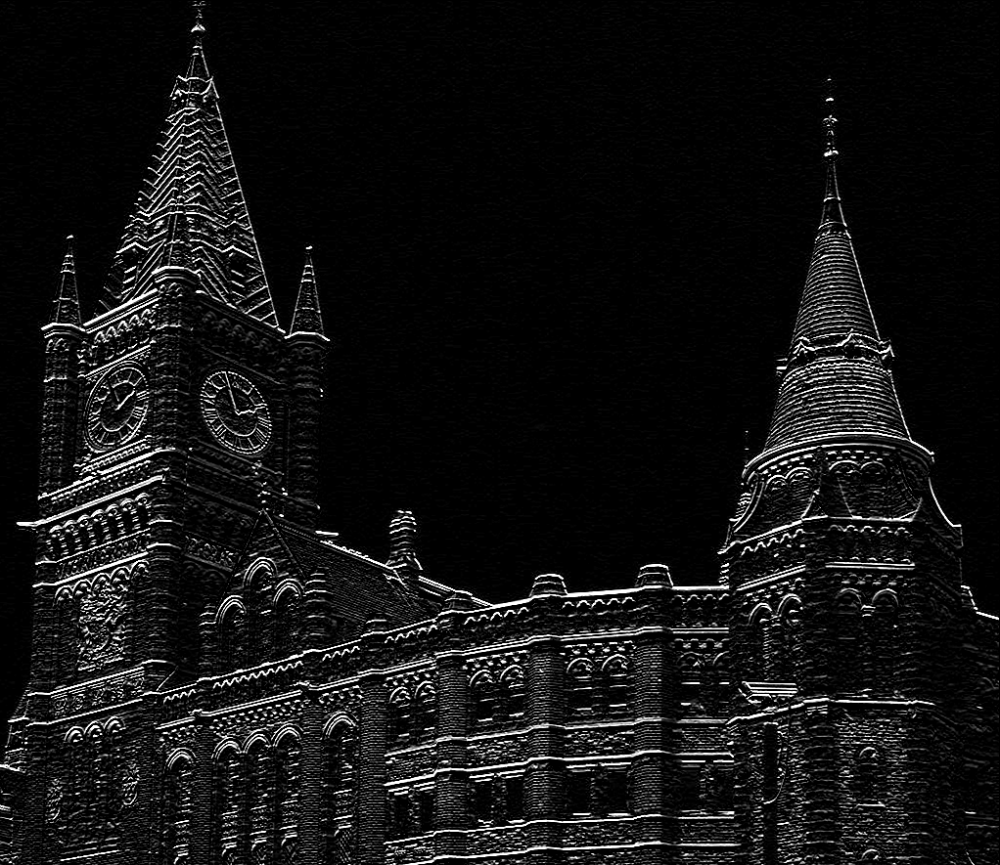

[[   0.    0.    0. ...    0.    0.    0.]
 [   0.    0.    0. ...   -1.   -3.    0.]
 [  -5.   -5.   -5. ...   -5.   -4.    0.]
 ...
 [-107. -114.  -53. ...  -19.   17.    0.]
 [   5.  -11.  -25. ...    8.  -10.    0.]
 [  49.   26.    9. ...   51.   -6.    0.]]


In [10]:
kernel = np.array([[1,3,1],[0,0,0],[-1,-3,-1]])
dst2 = conv2d(gray2, kernel)
print(dst2.shape)
cv2_imshow(dst2)
print(dst2)

### 5x5 Edge Kernel Test

(467, 596)


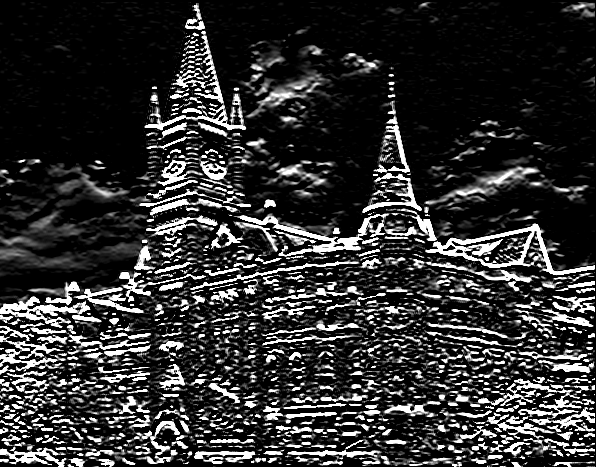

[[  0.   0.   0. ...   0.   0.   0.]
 [  0.   0.   0. ...   0.   0.   0.]
 [  0.   0.   0. ...  10.   7.   0.]
 ...
 [  0.   0.   0. ...   0.   0.   0.]
 [  0.   0.   0. ...   0.   0.   0.]
 [  0.   0.   0. ...  76. 104.   0.]]


In [6]:
kernel = np.array([[1,2,3,2,1],[2,3,5,3,2],[0,0,0,0,0],[-2,-3,-5,-3,-2],[-1,-2,-3,-2,-1]])
dst = conv2d(gray, kernel)
print(dst.shape)
cv2_imshow(dst)
print(np.clip(dst,0,255))

(883, 1020)


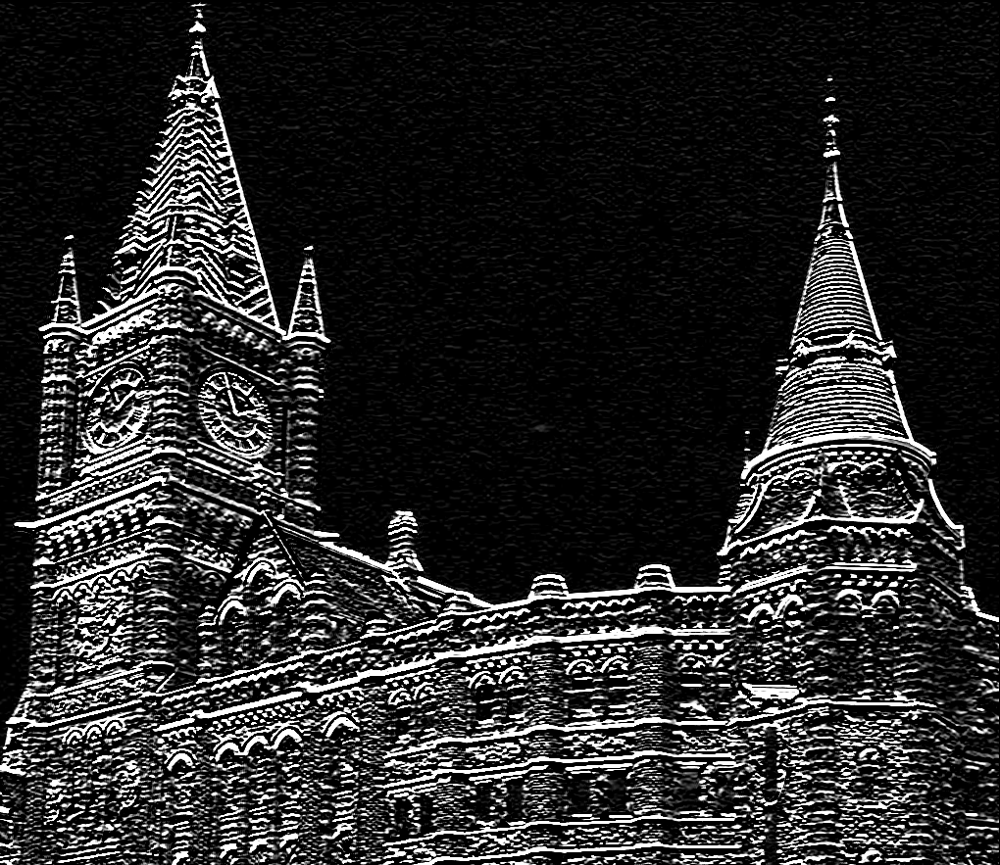

[[   0.    0.    0. ...    0.    0.    0.]
 [   0.    0.    0. ...    0.    0.    0.]
 [ -24.  -24.  -24. ...  -21.  -21.    0.]
 ...
 [ 379.  456.  399. ...   14.   76.    0.]
 [-172.   34.   22. ...  -11.   72.    0.]
 [-381. -266. -313. ...  -48.   -5.    0.]]


In [11]:
kernel = np.array([[1,2,3,2,1],[2,3,5,3,2],[0,0,0,0,0],[-2,-3,-5,-3,-2],[-1,-2,-3,-2,-1]])
dst2 = conv2d(gray2, kernel)
print(dst2.shape)
cv2_imshow(dst2)
print(dst2)

### 3x3 Gaussian

(469, 598)


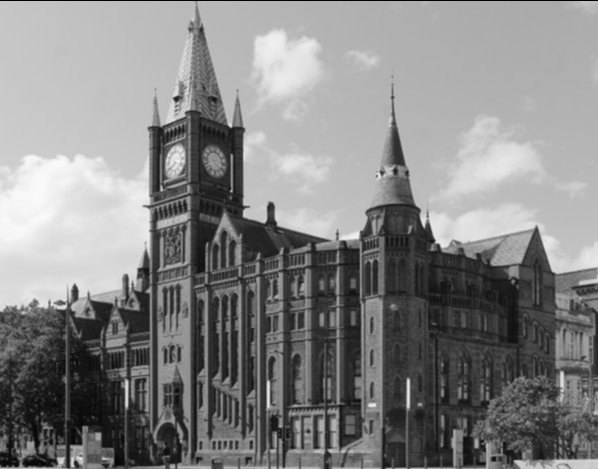

[[  0.       0.       0.     ...   0.       0.       0.    ]
 [197.     197.     197.     ... 188.0625 186.9375 185.1875]
 [197.     197.     197.     ... 188.625  187.3125 185.6875]
 ...
 [109.9375  61.3125  40.625  ... 204.9375 204.8125 204.75  ]
 [130.6875 117.5    111.125  ... 202.5    202.375  200.625 ]
 [180.9375 181.625  181.1875 ... 198.5    199.25   197.    ]]


In [ ]:
kernel = np.array([[1,2,1],[2,4,2],[1,2,1]])*(1/16)
dst = conv2d(gray, kernel)
print(dst.shape)
cv2_imshow(dst)
print(dst)

(885, 1022)


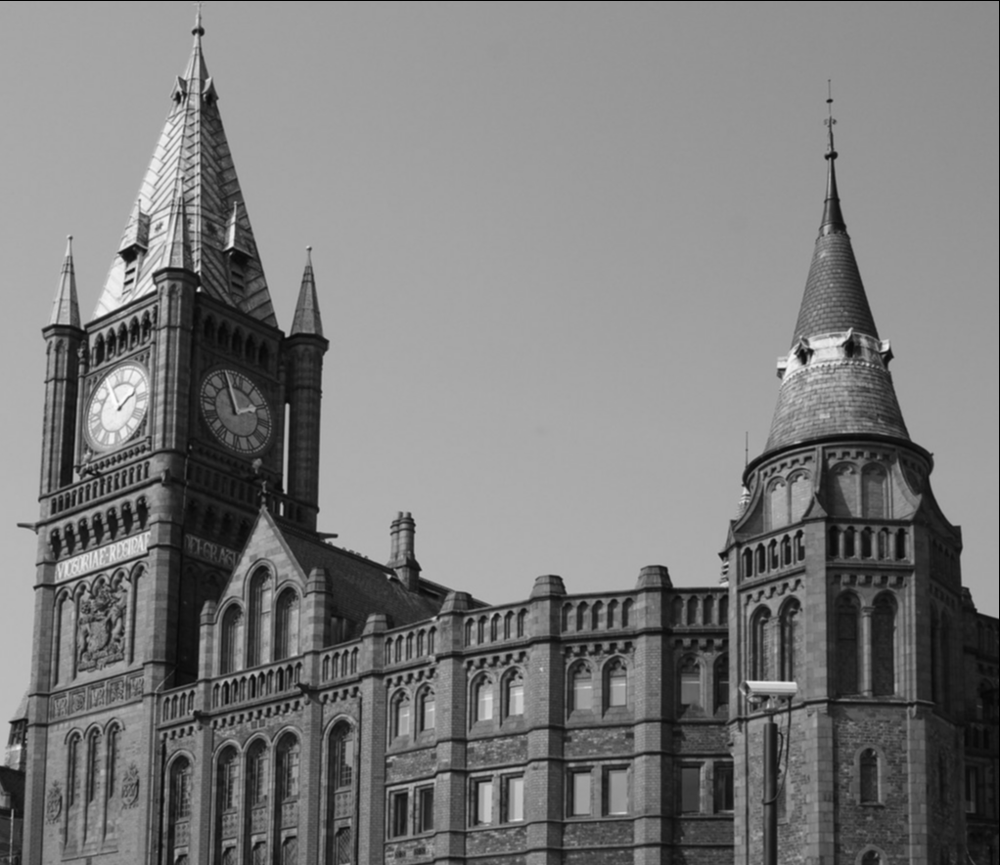

[[  0.       0.       0.     ...   0.       0.       0.    ]
 [165.     165.     165.     ... 137.0625 137.375    0.    ]
 [165.25   165.25   165.25   ... 137.375  137.6875   0.    ]
 ...
 [ 67.5625  65.0625  62.125  ...  31.375   26.625    0.    ]
 [ 72.9375  70.5625  67.125  ...  31.9375  26.3125   0.    ]
 [ 70.5     69.4375  68.6875 ...  29.25    26.9375   0.    ]]


In [12]:
kernel = np.array([[1,2,1],[2,4,2],[1,2,1]])*(1/16)
dst2 = conv2d(gray2, kernel)
print(dst2.shape)
cv2_imshow(dst2)
print(dst2)

##cv2 comparison

### 3x3 Edge

(471, 600)


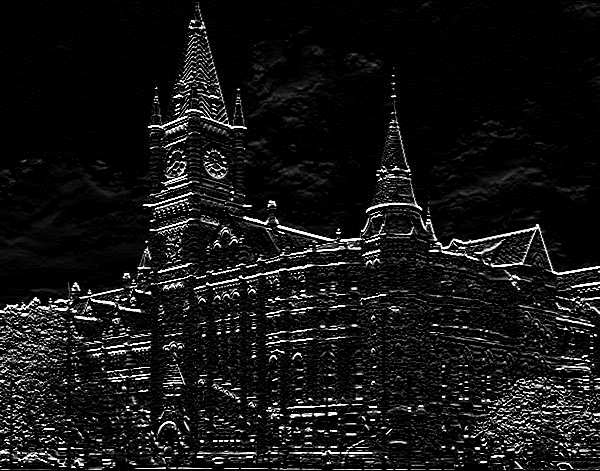

[[  0   0   0 ...   0   0   0]
 [  0   0   0 ...   0   0   0]
 [  0   0   0 ...   0   0   0]
 ...
 [  0   0   0 ...  28  36  40]
 [ 91 130 199 ... 208 112  71]
 [  0   0   0 ...   0   0   0]]


In [ ]:
kernel = np.array([[1,3,1],[0,0,0],[-1,-3,-1]])
dst = cv2.filter2D(gray,-1,kernel)     # apply the filter
print(dst.shape)
cv2_imshow(dst)
print(dst)

(887, 1024)


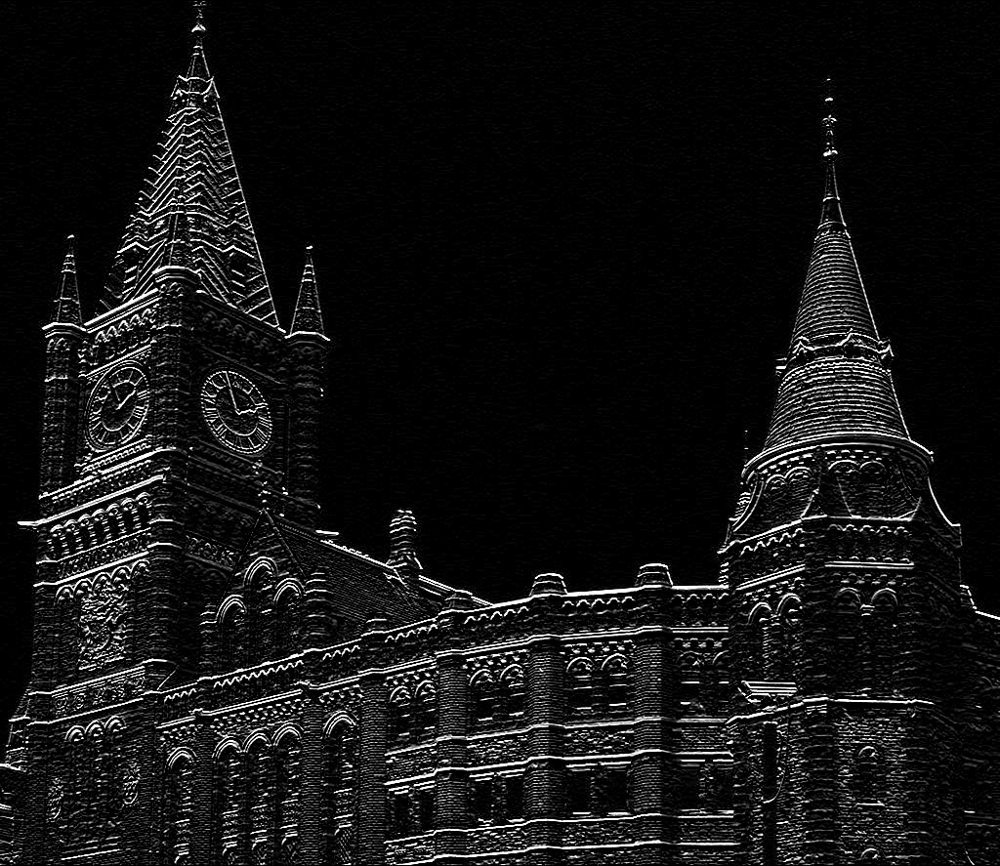

[[  0   0   0 ...   0   0   0]
 [  0   0   0 ...   0   0   0]
 [  0   0   0 ...   0   0   0]
 ...
 [ 61  49  26 ...   0   0   0]
 [215 149  83 ...   0   0   0]
 [  0   0   0 ...   0   0   0]]


In [14]:
kernel = np.array([[1,3,1],[0,0,0],[-1,-3,-1]])
dst2 = cv2.filter2D(gray2, -1, kernel)
print(dst2.shape)
cv2_imshow(dst2)
print(dst2)

### 5x5 Edge

(471, 600)


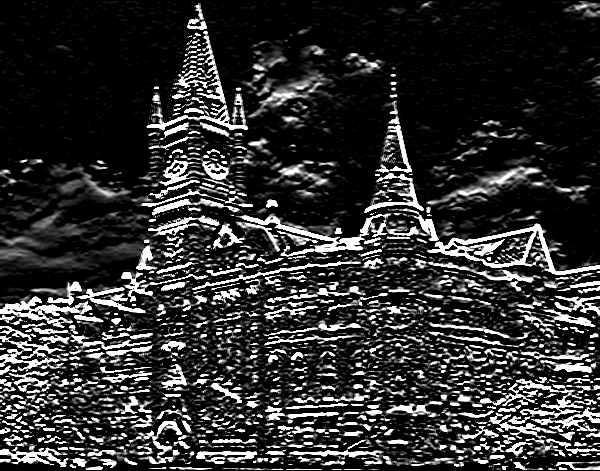

[[  0   0   0 ...   0   0   0]
 [  0   0   0 ...   0   0   0]
 [  0   0   0 ...   4   0   0]
 ...
 [  0   0   0 ... 255 255 255]
 [  0   0   0 ... 255 255 255]
 [  0   0   0 ...   0   0   0]]


In [10]:
kernel = np.array([[1,2,3,2,1],[2,3,5,3,2],[0,0,0,0,0],[-2,-3,-5,-3,-2],[-1,-2,-3,-2,-1]])
dst = cv2.filter2D(gray,-1,kernel)     # apply the filter
print(dst.shape)
cv2_imshow(dst)
print(dst)

(887, 1024)


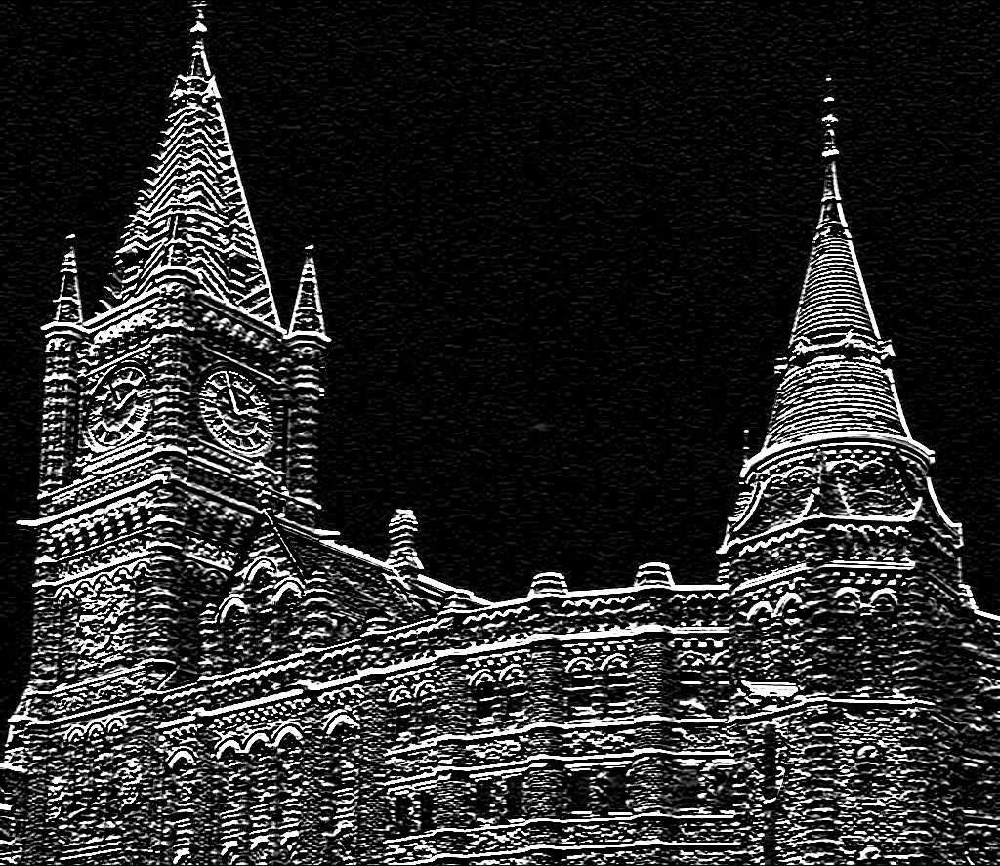

[[  0   0   0 ...   0   0   0]
 [  0   0   0 ...   0   0   0]
 [  0   0   0 ...   0   0   0]
 ...
 [255 255 235 ...  12   0   0]
 [255 255 255 ...  20   0   0]
 [  0   0   0 ...   0   0   0]]


In [15]:
kernel = np.array([[1,2,3,2,1],[2,3,5,3,2],[0,0,0,0,0],[-2,-3,-5,-3,-2],[-1,-2,-3,-2,-1]])
dst2 = cv2.filter2D(gray2, -1, kernel)
print(dst2.shape)
cv2_imshow(dst2)
print(dst2)

### Gaussian

(471, 600)


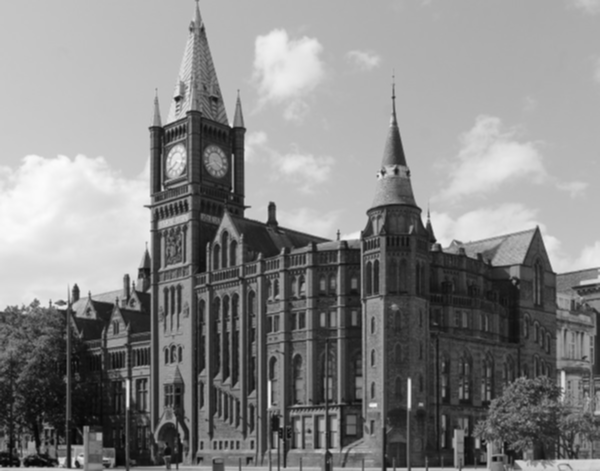

[[197 197 197 ... 187 185 184]
 [197 197 197 ... 187 185 184]
 [197 197 197 ... 187 186 185]
 ...
 [180 181 182 ... 199 197 196]
 [199 197 193 ... 188 189 190]
 [194 191 184 ... 178 183 186]]


In [ ]:
kernel = np.array([[1,2,1],[2,4,2],[1,2,1]])*(1/16)
dst = cv2.filter2D(gray,-1,kernel)     # apply the filter
print(dst.shape)
cv2_imshow(dst)
print(dst)

(887, 1024)


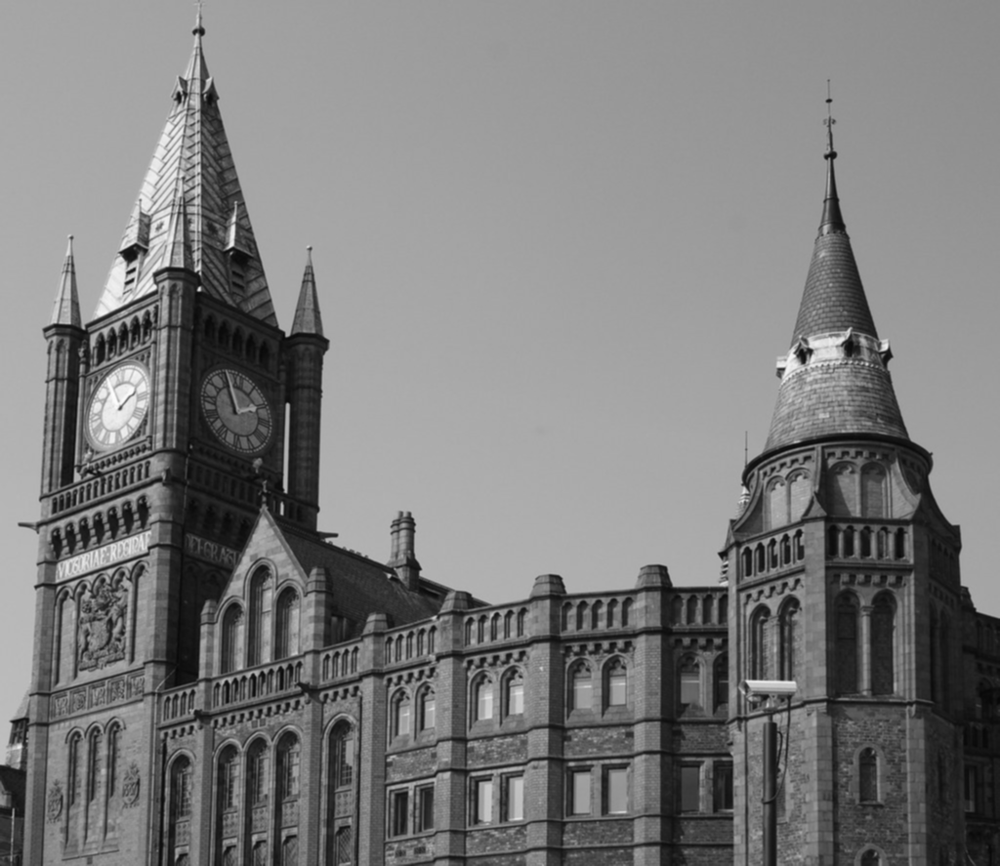

[[165 165 165 ... 137 138 138]
 [165 165 165 ... 137 138 138]
 [165 165 165 ... 138 138 138]
 ...
 [ 71  70  69 ...  27  26  25]
 [ 58  61  64 ...  27  29  28]
 [ 48  53  59 ...  27  30  30]]


In [16]:
kernel = np.array([[1,2,1],[2,4,2],[1,2,1]])*(1/16)
dst2 = cv2.filter2D(gray2, -1, kernel)
print(dst2.shape)
cv2_imshow(dst2)
print(dst2)

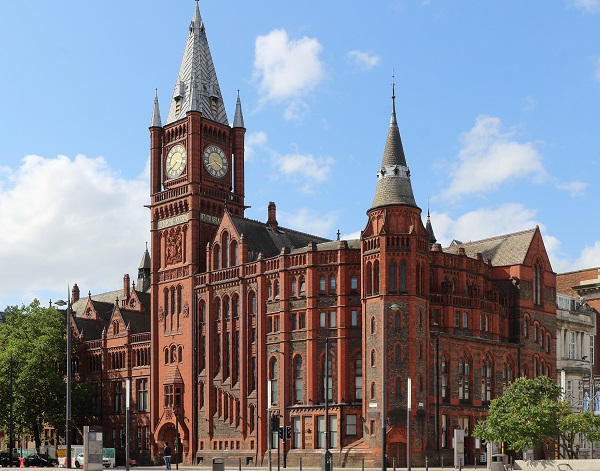

In [3]:
#@title Problem 2
img1 = cv2.imread("victoria.jpg")
cv2_imshow(img1)

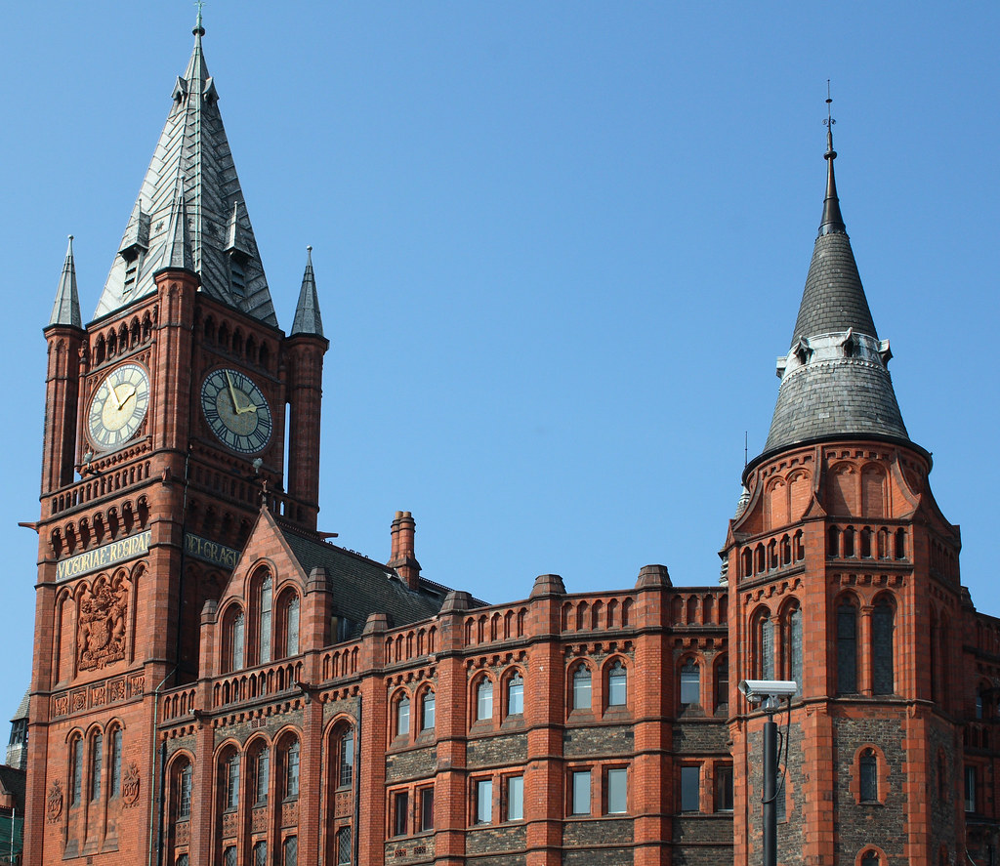

In [4]:
img2 = cv2.imread("victoria2.jpg")
cv2_imshow(img2)

SIFT

In [18]:
img1g = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)
img2g = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)

In [19]:
sift = cv2.xfeatures2d.SIFT_create()

In [20]:
kp1, des1 = sift.detectAndCompute(img1g, None)
kp2, des2 = sift.detectAndCompute(img2g, None)

1701


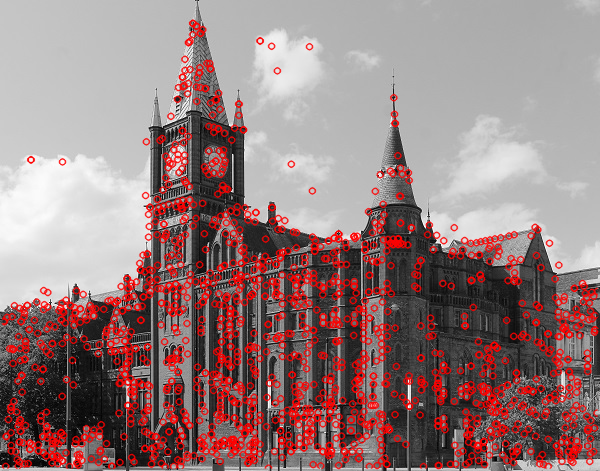

In [9]:
img_sift1 = cv2.drawKeypoints(img1g, kp1, None, (0,0,255), 2)
print(len(kp1))
cv2_imshow(img_sift1)

4858


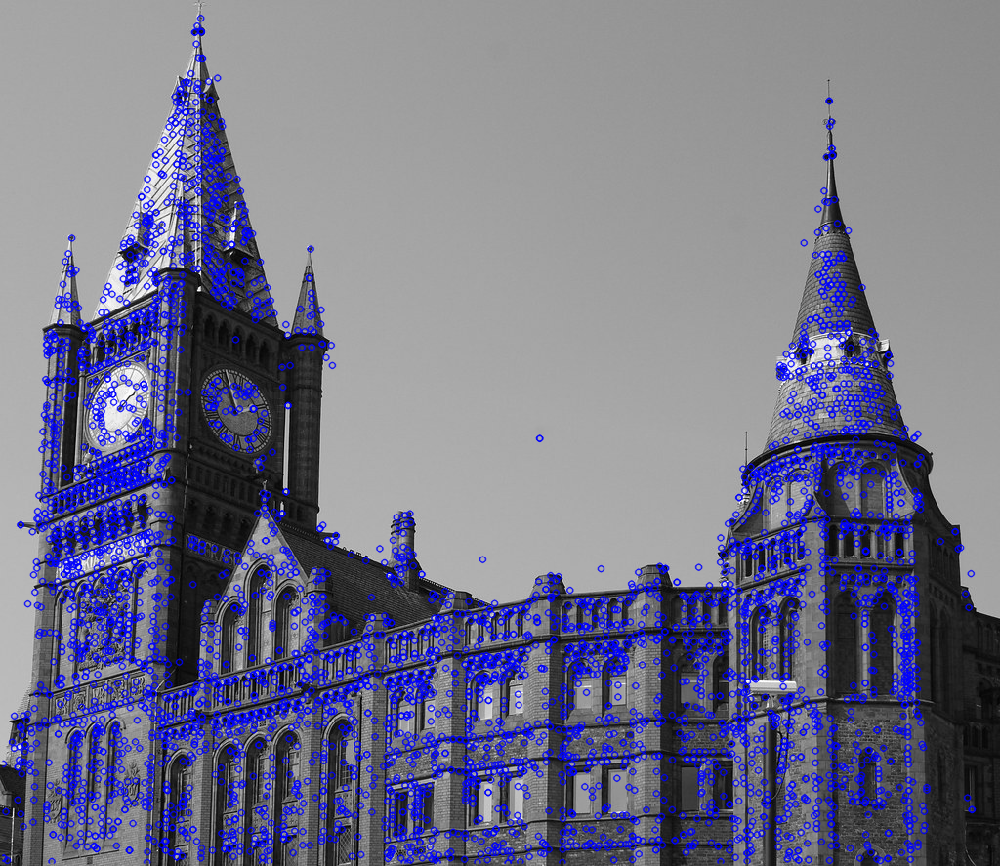

In [10]:
img_sift2 = cv2.drawKeypoints(img2g, kp2, None, (255,0,0), 2)
print(len(kp2))
cv2_imshow(img_sift2)

1350
The SIFT match time in seconds are: 0.7180142402648926


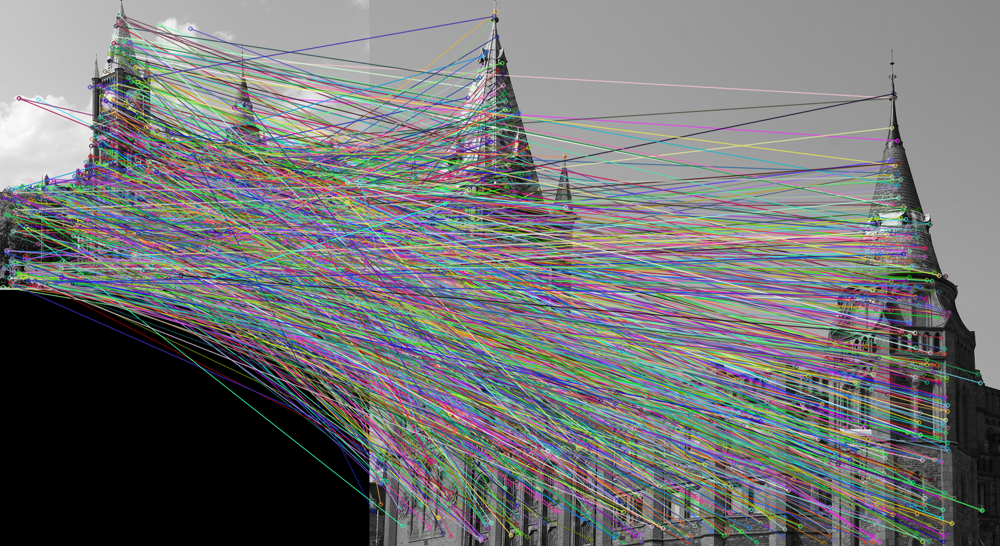

In [21]:
bf = cv2.BFMatcher(cv2.NORM_L2, crossCheck=True)
t = time.time()
matches = bf.match(des1, des2)
print(len(matches))
matches = sorted(matches, key=lambda d:d.distance)
t_end = time.time()
imc = cv2.drawMatches(img1g, kp1, img2g, kp2, matches, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
print(f"The SIFT match time in seconds are: {t_end-t}")
cv2_imshow(imc)

SURF

In [22]:
surf = cv2.xfeatures2d.SURF_create()
kp1, des1 = surf.detectAndCompute(img1, None)
kp2, des2 = surf.detectAndCompute(img2, None)

2945


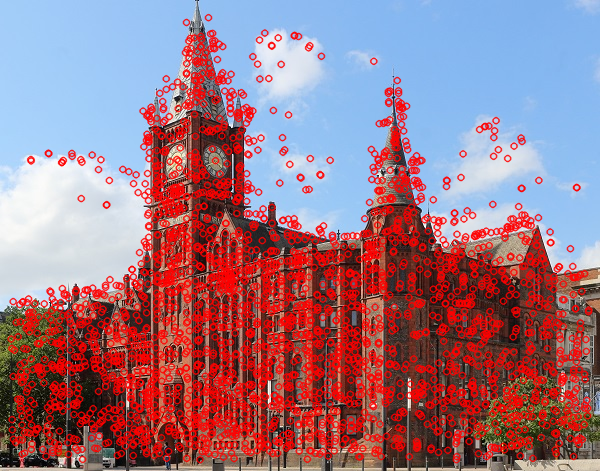

In [12]:
img_surf1 = cv2.drawKeypoints(img1, kp1, None, (0,0,255), 2)
print(len(kp1))
cv2_imshow(img_surf1)

8185


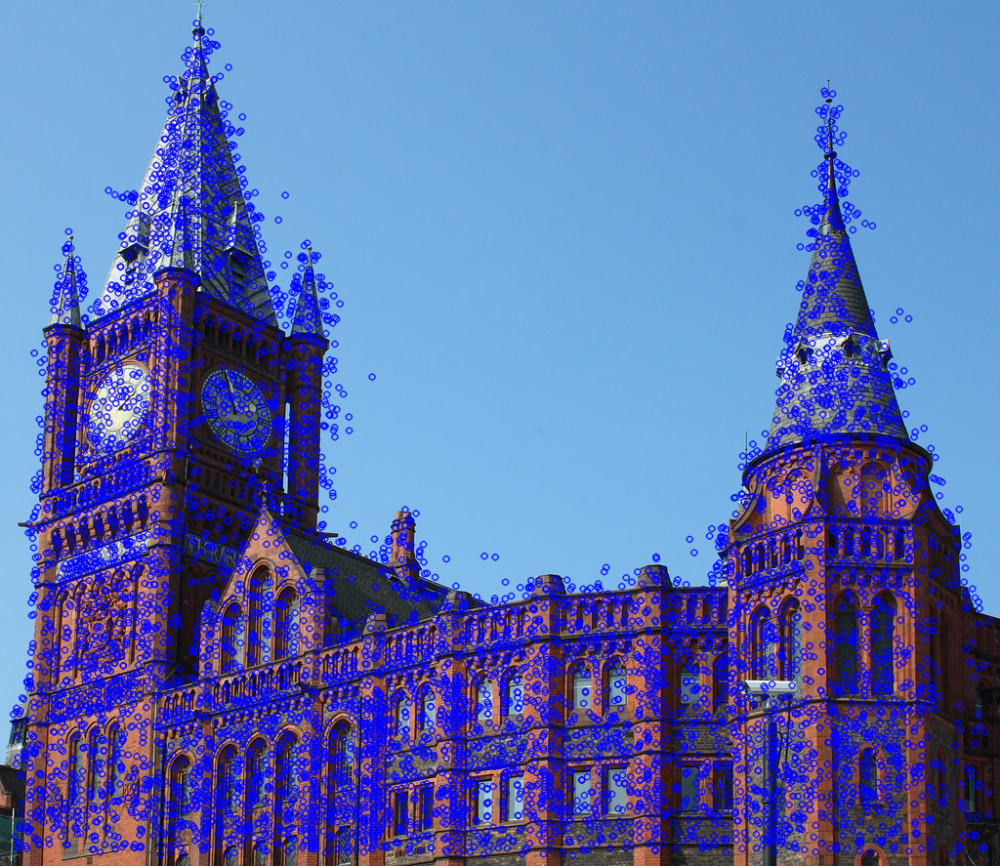

In [13]:
img_surf2 = cv2.drawKeypoints(img2, kp2, None, (255,0,0), 2)
print(len(kp2))
cv2_imshow(img_surf2)

2073
The SURF match time in seconds are: 1.0204286575317383


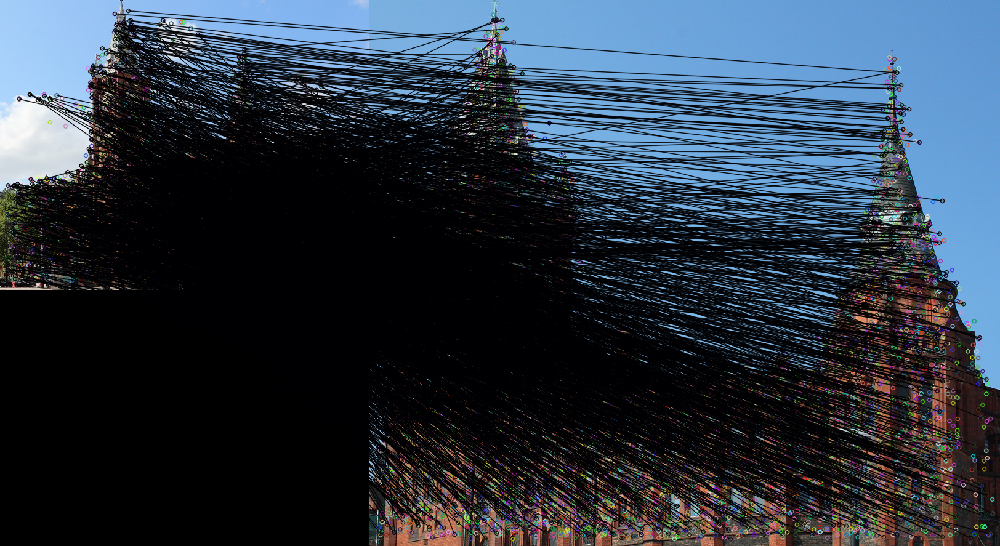

In [23]:
bf = cv2.BFMatcher(cv2.NORM_L2, crossCheck=True)
t = time.time()
matches = bf.match(des1, des2)
print(len(matches))
matches = sorted(matches, key=lambda d: d.distance)
t_end = time.time()
imc = cv2.drawMatches(img1, kp1, img2, kp2, matches, None, 2)
print(f"The SURF match time in seconds are: {t_end-t}")
cv2_imshow(imc)

ORB

In [24]:
orb = cv2.ORB_create()

In [25]:
kp1 = orb.detect(img1, None)
kp2 = orb.detect(img2, None)

In [26]:
kp1, des1 = orb.compute(img1, kp1)
kp2, des2 = orb.compute(img2, kp2)

500


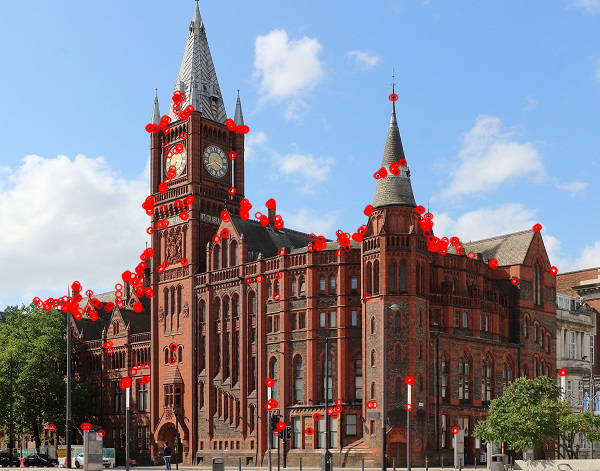

In [17]:
img_orb1 = cv2.drawKeypoints(img1, kp1, None, (0,0,255), 2)
print(len(kp1))
cv2_imshow(img_orb1)

500


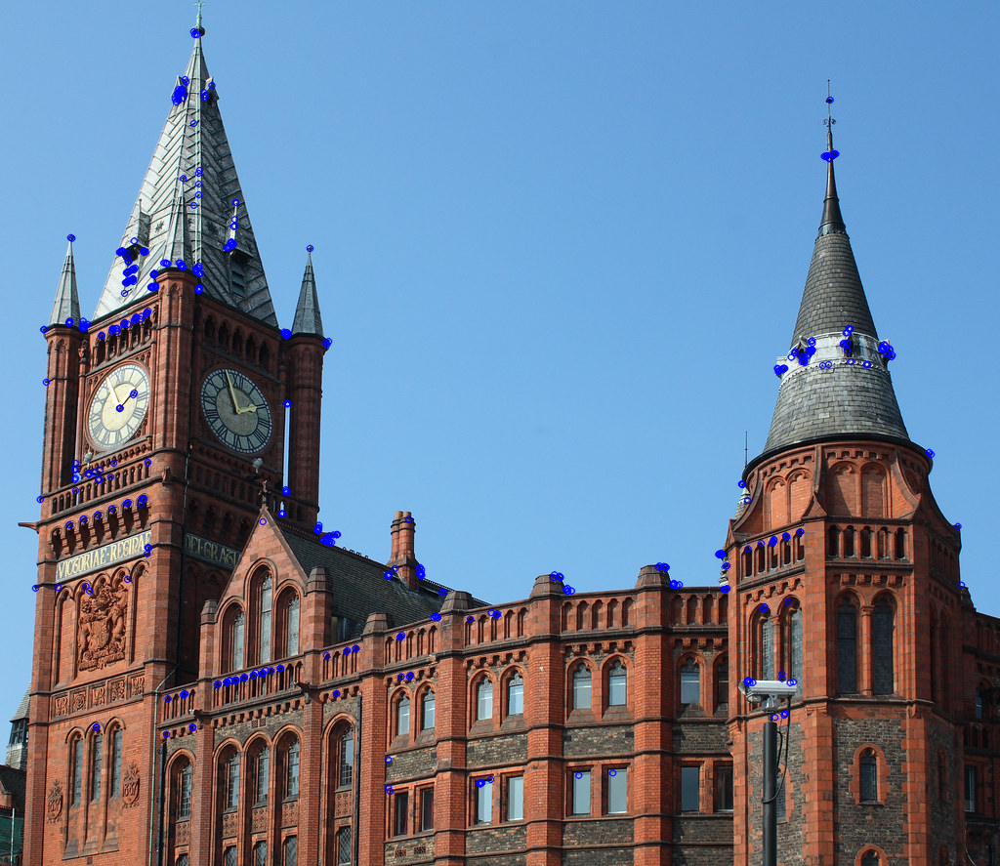

In [18]:
img_orb2 = cv2.drawKeypoints(img2, kp2, None, (255,0,0), 2)
print(len(kp2))
cv2_imshow(img_orb2)

252
The ORB match time in seconds are: 0.014475107192993164


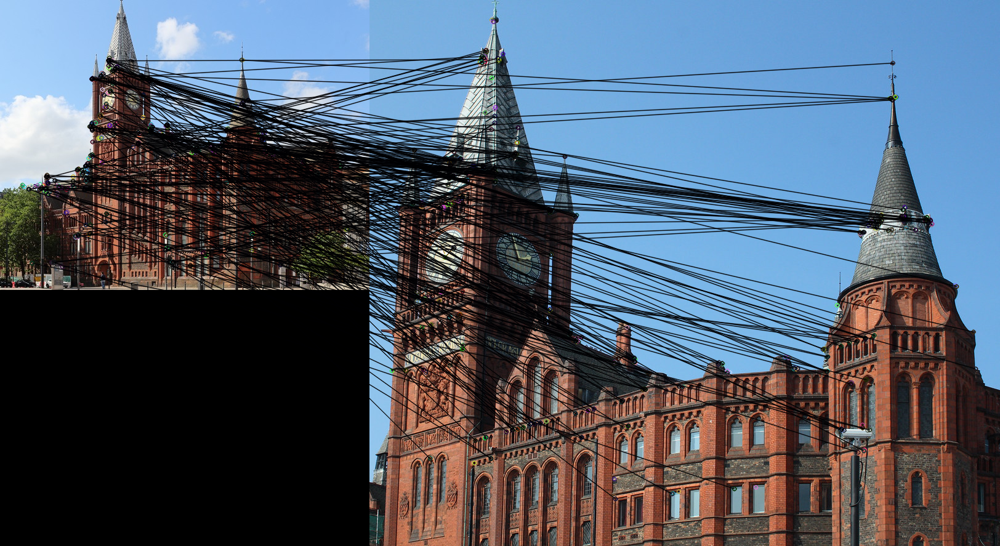

In [27]:
bf = cv2.BFMatcher(cv2.NORM_L2, crossCheck=True)
t = time.time()
matches = bf.match(des1, des2)
print(len(matches))
matches = sorted(matches, key=lambda d: d.distance)
t_end = time.time()
imc = cv2.drawMatches(img1, kp1, img2, kp2, matches, None, 2)
print(f"The ORB match time in seconds are: {t_end-t}")
cv2_imshow(imc)